In [1]:
# importing libraries
import numpy as np
import matplotlib.pyplot as plt
import logging
from tqdm.auto import trange, tqdm
from matplotlib import cm
#from matplotlib.colors import Normalize, ListedColormap, LinearSegmentedColormap
#from matplotlib.cm import ScalarMappable

from scipy.optimize import curve_fit
import json
import arviz as az

# import custom class
from RandomLoop import StateSpace, create_cmap
from IPython.display import HTML

# import custom class
#from StateSpace_old import stateSpace, create_cmap

MEDIA_PATH = r'C:\Users\lollo\Documents\Università\Thesis\Media/'

#plt.style.use("default")
plt.style.use("dark_background")
#plt.style.use("seaborn-v0_8-pastel")
#plt.style.use("fast")

In [ ]:
# logging settings
logger = logging.getLogger()

#logger.setLevel(logging.CRITICAL + 1) # To turn off
logger.setLevel(logging.INFO)  

In [ ]:
%%html
<style>
.cell-output-ipywidget-background {
    background-color: transparent !important;
}
:root {
    --jp-widgets-color: var(--vscode-editor-foreground);
    --jp-widgets-font-size: var(--vscode-editor-font-size);
}  
</style>

# Basic usage

  0%|          | 0/2000000 [00:00<?, ?it/s]

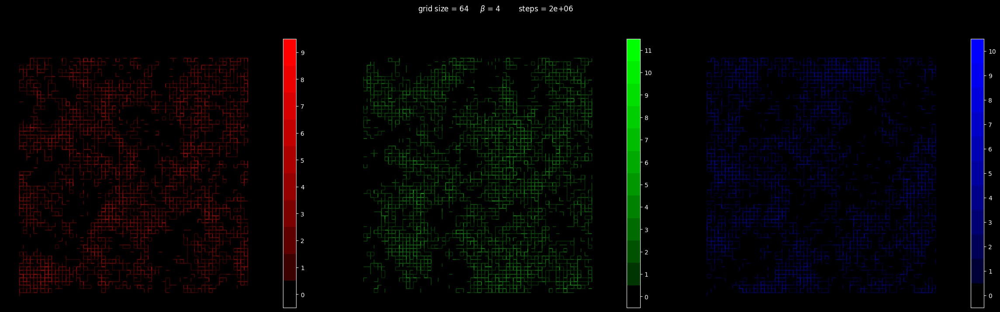

In [29]:
# initialize the grid
m = StateSpace(num_colors = 3, grid_size = 64, beta = 4, init = 0, bc = 0)  

# run it
#m.step(500_000)
m.step(num_steps=2_000_000, sample_rate=10_000, observables=[m.get_grid]) #, sample_rate=10_000, observables=[m.mean_links, m.std_links, m.get_grid]) #, sample_rate=10_000, observables=[m.compute_corr, m.mean_links]) # about 3 seconds for 100k steps on my PC

# plot it
#m.plot_overlap(alpha = 0.9, normalized = True, file_name = MEDIA_PATH + 'overlap_cool.pdf', linewidth = 1) #, file_name = '64_0_9_U2.pdf')
#m.plot_overlap(normalized=True)
m.plot_grid()

#m.summary()

# Assuming `trace` is your MCMC trace object from a PyMC3 model
#trace = np.mean(m.data['mean_loop_length'], axis=1)
#ess = az.ess(trace)

#print(ess)

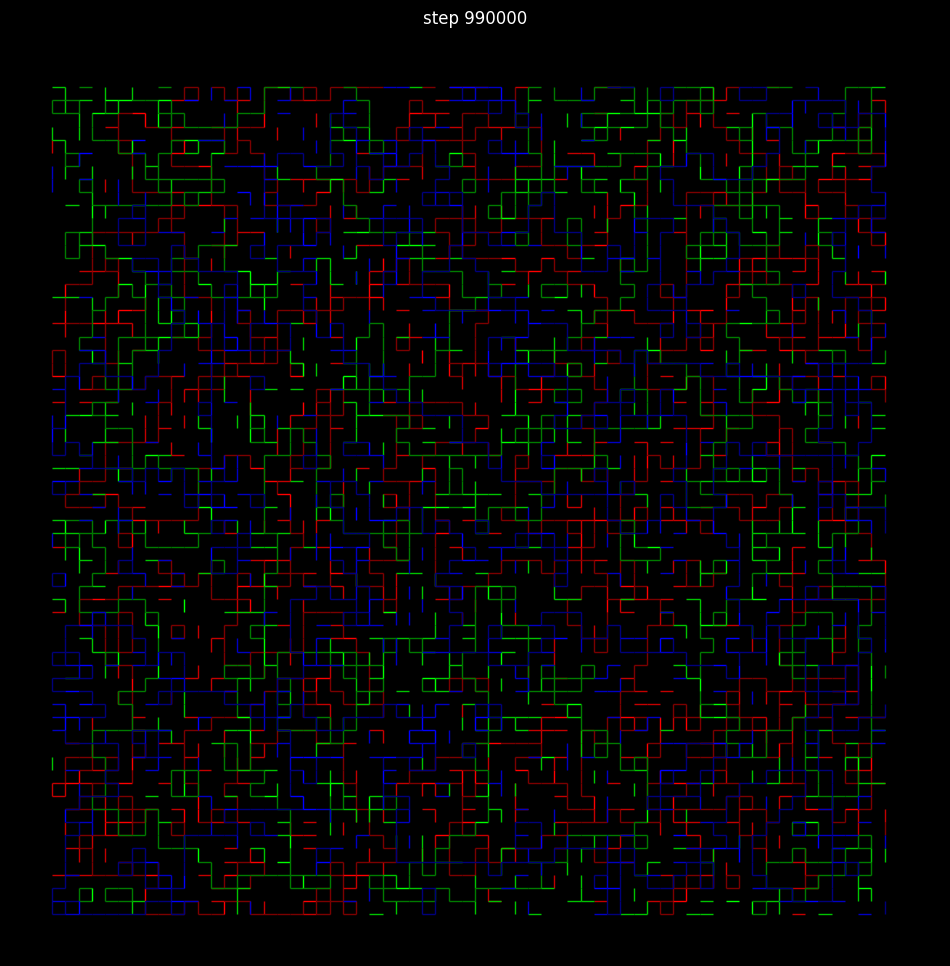

In [3]:
ani = m.animate()
HTML(ani.to_jshtml())

<xarray.DataArray 'mean links' ()> Size: 8B
array(174.30165899)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mean links,2.208,0.017,2.176,2.24,0.001,0.001,174.0,484.0,1.0


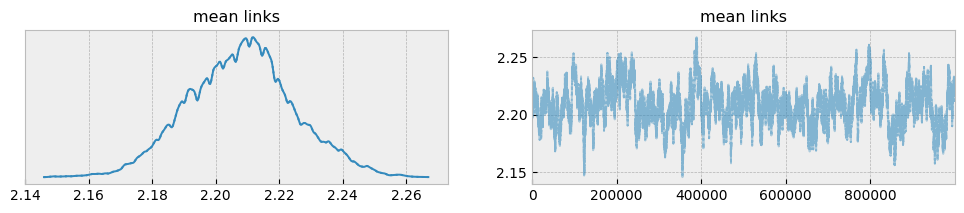

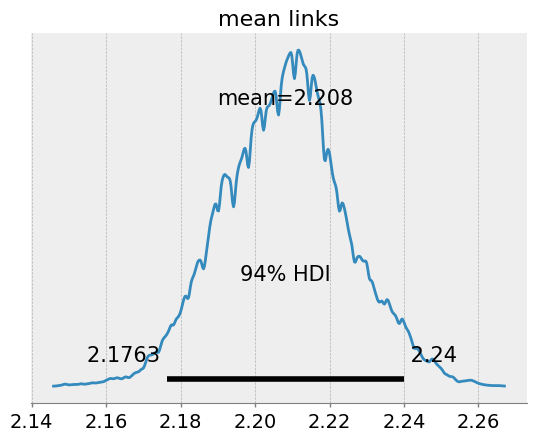

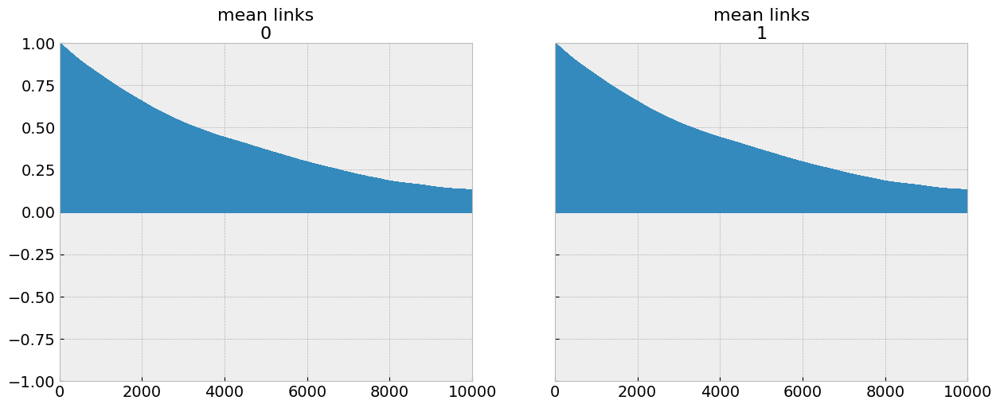

In [53]:
plt.style.use("bmh")
trace = np.sum(m.data['mean_links'], axis=1)

# Create an InferenceData object from the numpy array if needed
idata = az.convert_to_inference_data({"mean links": [trace, trace]})

az.plot_trace(idata)
az.plot_posterior(idata, round_to=5)
az.plot_autocorr(idata, max_lag=10000)
print(az.ess(idata)['mean links'])
az.summary(idata)

In [25]:
data_t = np.transpose(data['data'], axes=[0,2,1])
data_t.shape

(8, 129, 4)

C:\Users\lollo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\arviz\plots\essplot.py:205: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  n_draws = data.dims["draw"]
C:\Users\lollo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\arviz\plots\essplot.py:206: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  n_samples = n_draws * data.dims["chain"]


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
x[0],0.008,0.088,0.000,0.000,0.003,0.002,214.0,209.0,1.01
x[1],0.021,0.101,0.000,0.082,0.008,0.005,27.0,25.0,1.22
x[2],0.074,0.137,0.000,0.310,0.023,0.016,13.0,51.0,1.75
x[3],0.359,0.119,0.212,0.566,0.028,0.020,13.0,61.0,1.70


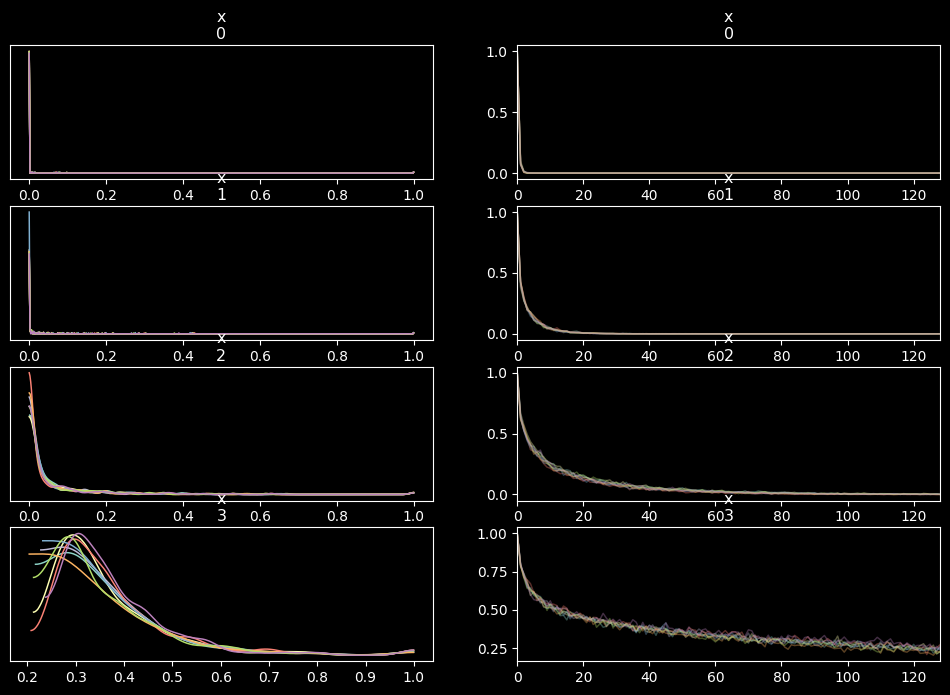

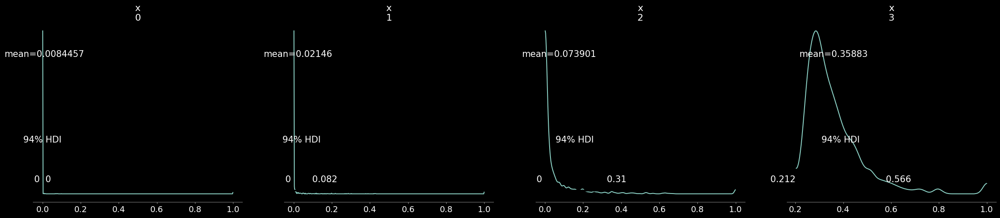

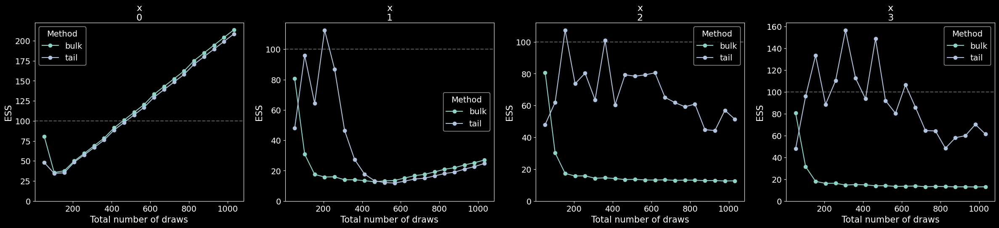

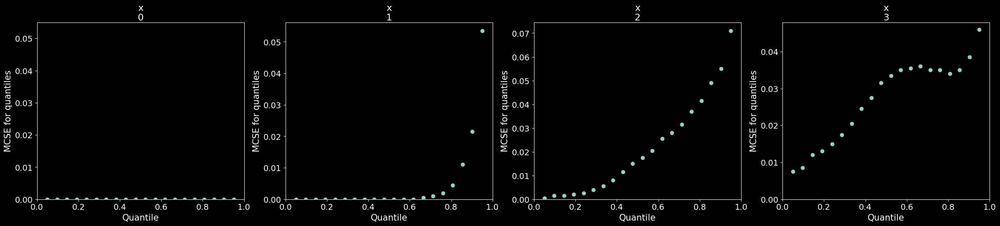

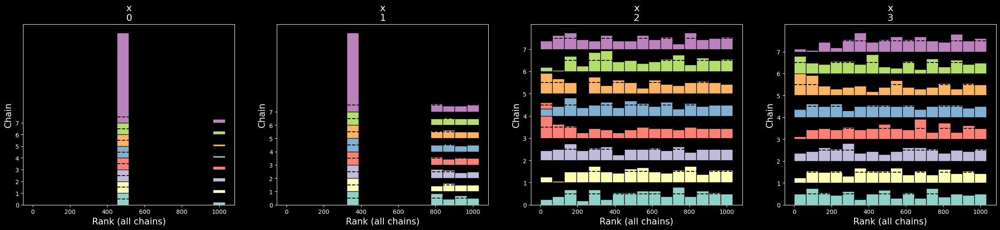

In [26]:
with open('corr_3_256_2024-03-17_12_29_40.json', 'r') as file:
    data = json.load(file)
    

idata = az.convert_to_inference_data(data_t)
az.plot_trace(idata, compact=False)
az.plot_posterior(idata, round_to=5)
#az.plot_autocorr(idata, max_lag=100)
az.plot_ess(idata, kind='evolution', extra_kwargs={"color": "lightsteelblue"}, min_ess=100)
az.plot_mcse(idata)
az.plot_rank(idata)
az.summary(idata)

In [109]:
s = np.std(data['mean links'])
mu = np.mean(data['mean links'])
N = len(data['mean links'])
print(f'{mu} +/- {1.96*s} {az.mcse(idata)}')

print( (1.4612-1.3982) / 2)

1.4323542465209962 +/- 0.03297470898837017 <xarray.Dataset> Size: 8B
Dimensions:     ()
Data variables:
    mean links  float64 8B 0.003302
0.03149999999999997


The basic ess (:math:`N_{\mathit{eff}}`) diagnostic is computed by:

  $$
  \hat{N}_{\mathit{eff}} = \frac{MN}{\hat{\tau}}
$$

$$
\hat{\tau} = -1 + 2 \sum_{t'=0}^K \hat{P}_{t'}
$$

    where :math:`M` is the number of chains, :math:`N` the number of draws,
    :math:`\hat{\rho}_t` is the estimated _autocorrelation at lag :math:`t`, and
    :math:`K` is the last integer for which :math:`\hat{P}_{K} = \hat{\rho}_{2K} +
    \hat{\rho}_{2K+1}` is still positive.

    The current implementation is similar to Stan, which uses Geyer's initial monotone sequence
    criterion (Geyer, 1992; Geyer, 2011).

- 2.1774-2.2513 94% mean 2.2135 for sample_rate = 1000 
- 2.1713-2.2427     mean 2.2088                 = 100
- 2.24-2.1763             2.208                    10

In [50]:
print(-2.1774+2.2513 )
print(-2.1713+2.2427)
print((2.24-2.1763) / 1.96)


0.07390000000000008
0.07140000000000013
0.03250000000000016


In [6]:
%matplotlib notebook

from IPython.display import HTML

ani = m.animate()
HTML(ani.to_jshtml())

AssertionError: to generate an animation first sample the grid state using the method "get_grid"

# Metropolis vs Glauber

We compare the two:
1. **performance**: same
2. **mixing time**: Glauber is slower, explainable by $P_{glabuer}(accept) \leq P_{metropolis}(accept)$
3. **frozing**: same

The samples are autocorrelated. Even though over the long term they do correctly follow $\displaystyle P(x)$, 

a set of nearby samples will be correlated with each other and not correctly reflect the distribution. 

This means that effective sample sizes can be significantly lower than the number of samples actually taken, leading to large errors.

### Counter measures for frozing

1. perturb state with some steps at low/high beta
2. restart the chain with some 'near' eq state, like uniform with the right mean links 

**Autocorrelation** is defined, Given observable $O(t)$ as:
$$
C_O(t) := \frac{\langle O(t+t')O(t')\rangle - \langle O \rangle^2}{ \langle O^2 \rangle - \langle O \rangle^2} \qquad \langle O(t+t')O(t')\rangle := \frac{1}{t_s-t} \sum_{t'= 0}^{t_s-t} O(t+t')O(t')
$$
We see that
$$
C_O(t) \xrightarrow{t \to \infty} 0 \qquad C_O(0) = 1
$$

We assume that 
$$
C_O(t) = A e^{-\frac t\tau}
$$
with $\tau$ some coherence time.

We $steps = 3\tau$ we should be fine.

In [ ]:
# initialize the grid
m = StateSpace(num_colors = 3, grid_size = 64, beta = 2)
m.step(500_000)

In [ ]:
#m.clear_data()
m.step(1_000_000, sample_rate=10_000, observables=['compute_corr', m.mean_links], perturb=True)

data = m.data['compute_corr']

In [ ]:
def autocorrelation(data, max_lag=None):
    """
    Calculate the time autocorrelation of an observable from an array of data.

    Parameters:
    - data: An array of observations.
    - max_lag: The maximum lag to calculate the autocorrelation for. If None, it's set to half of the data length.

    Returns:
    - A numpy array containing the autocorrelation values for lags up to max_lag.
    """
    if max_lag is None:
        max_lag = len(data) // 2
    mean_data = np.mean(data)
    var_data = np.var(data)
    autocorr = np.empty(max_lag+1)
    for lag in range(max_lag+1):
        if lag == 0:
            autocorr[lag] = 1  # Autocorrelation at lag 0 is always 1
        else:
            cov = np.mean((data[:-lag] - mean_data) * (data[lag:] - mean_data))
            autocorr[lag] = cov / var_data
    return autocorr[:-1]

max_lag = 100

# Example usage:
# data = np.random.randn(1000)  # Random dataset
autocorr_values = autocorrelation(data, max_lag=max_lag)


def my_exp(x, a, tau):
    return a*np.exp(-x/tau)

p, pcov = curve_fit(my_exp, list(range(max_lag)), autocorr_values)

print(r'a = {:.3f} +/- {:.3f}     tau = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [my_exp(x, p[0], p[1]) for x in range(max_lag)]

plt.plot(range(max_lag),y, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(range(max_lag), autocorr_values, marker='.', label = 'data', zorder = 2)
plt.legend()
plt.show()


Find $\beta$ dependance of $\tau$, we fix grid_size = 64 and num_colors = 3.

In [ ]:
betas = [1, 5, 10, 15, 20, 25]

taus = []

for beta in tqdm(betas):
    # initialize the grid
    m = StateSpace(num_colors=3, grid_size=64, beta=beta)
    # reach eq
    m.step(1_000_000,progress_bar=False)
    # record data
    m.clear_data()
    m.step(1_000_000, sample_rate=1_000, observables=['compute_corr'], progress_bar=False)

    data = m.data['compute_corr'][1]
    # compute autocorr
    autocorr_values = autocorrelation(data, max_lag=100)
    # find tau 
    p, pcov = curve_fit(my_exp, list(range(max_lag)), autocorr_values)
    taus.append(p[1])

In [ ]:
plt.plot(betas, taus)

# Study autocorrelation of observables

In [ ]:
m = StateSpace(3, 64, 10, algo='metropolis')
m.step(1_000_000, sample_rate=1_000, observables=[m.mean_links])


m2 = StateSpace(3, 64, 10, algo='glauber')
m2.step(1_000_000, sample_rate=1_000, observables=[m2.mean_links])

In [ ]:
def check_equilibrium(data, eps = 1e-3):
    v1 = np.mean(data[-100:-50])
    v2 = np.mean(data[-50:])
    
    if abs((v2-v1)/v2) <= eps:
        return True 
    return False 

for i in range(len(m.data['mean_links'])):
    if check_equilibrium(np.mean(m.data['mean_links'], axis=1)[:i*100]):
        print('m: eq reached at {}'.format(i*1000))
        break

for i in range(len(m2.data['mean_links'])):
    if check_equilibrium(np.mean(m2.data['mean_links'], axis=1)[:i*100]):
        print('g: eq reached at {}'.format(i*1000))
        break

plt.plot(np.mean(m.data['mean_links'], axis=1), label='metropolis')
plt.plot(np.mean(m2.data['mean_links'], axis=1), label='glauber')
plt.axvline(x=500)
plt.axvline(x=800)

plt.legend()
plt.show()

In [ ]:
# frozing 
m = StateSpace(3, 64, 5, algo='metropolis')
m.step(1_000_000)
m.plot_grid()

m2 = StateSpace(3, 64, 5, algo='glauber')
m2.step(1_000_000)
m2.plot_grid()

m.summary()

m2.summary()


In [ ]:
# perturb 
m.beta =  m.beta*0.1
m.step(10_000, sample_rate=1_000, observables=[m.mean_links])
m.beta = m.beta*10
m.step(10_000, sample_rate=1_000, observables=[m.mean_links])

m.beta = 5
m.step(100_000, sample_rate=1_000, observables=[m.mean_links])

plt.plot(np.mean(m.data['mean_links'], axis=1), label='metropolis')

# perturb
m2.beta = m2.beta*0.1 
m2.step(20_000, sample_rate=1_000, observables=[m2.mean_links])
m2.beta = m2.beta*10
m2.step(10_000, sample_rate=1_000, observables=[m2.mean_links])

m2.beta = 5
m2.step(100_000, sample_rate=1_000, observables=[m2.mean_links])

plt.plot(np.mean(m2.data['mean_links'], axis=1), label='glauber')

plt.legend()
plt.show()


# mean Links of different colors are anticorrelated



In [ ]:
# 2 colors mean links correlation

plt.figure(figsize=(12,8))

x = np.arange(0,3_000_000, 10_000)
mean = np.mean(m.data['mean_links'], axis = 1)

# remove first 10 datapoints
y_1 = np.array(m.data['mean_links']).T[0][10:]
y_2 = np.array(m.data['mean_links']).T[1][10:]


# correlation coeff.
corr = np.corrcoef(y_1, y_2)

plt.rcParams["axes.prop_cycle"] = plt.cycler('color', ['red', 'green', 'blue'])
plt.rcParams.update({'font.size': 16})

plt.plot(x, m.data['mean_links'], label = ['color 1','color 2'])
plt.plot(x, mean, linestyle = '--', label = 'global mean', color = 'orange')
plt.title('correlation coefficient = {:.3f}'.format(corr[0,1]))

plt.xlabel('steps')
plt.ylabel(r'$\langle m_e^i \rangle$')
plt.grid(linewidth=0.5, linestyle = '--')
plt.xticks(np.arange(0, 3_500_000, 500_000))
plt.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.legend()
# quick correlation check

plt.savefig(MEDIA_PATH + '2_cols_mean_links.pdf')


print('correlation coefficient = {:.3f}'.format(corr[0,1]))


In [ ]:
# 3 colors mean links correlation

plt.figure(figsize=(12,8))

x = np.arange(0,3_000_000, 10_000)
mean = np.mean(m.data['mean_links'], axis = 1)

# remove first 10 datapoints
y_1 = np.array(m.data['mean_links']).T[0][10:]
y_2 = np.array(m.data['mean_links']).T[1][10:]
y_3 = np.array(m.data['mean_links']).T[2][10:]

# correlation coeff.
corr_1 = np.corrcoef(y_1, y_2)
corr_2 = np.corrcoef(y_1, y_3)
corr_3 = np.corrcoef(y_2, y_3)

plt.rcParams["axes.prop_cycle"] = plt.cycler('color', ['red', 'green', 'blue'])
plt.rcParams.update({'font.size': 16})

plt.plot(x, m.data['mean_links'], label = ['color 1','color 2', 'color 3'])
plt.plot(x, mean, linestyle = '--', label = 'global mean', color = 'orange')
plt.title('correlation coefficient = {:.3f}'.format(corr[0,1]))

plt.xlabel('steps')
plt.ylabel(r'$\langle m_e^i \rangle$')
plt.grid(linewidth=0.5, linestyle = '--')
plt.xticks(np.arange(0, 3_500_000, 500_000))
plt.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.legend()
# quick correlation check

plt.savefig(MEDIA_PATH + '2_cols_mean_links.pdf')


print('correlation coefficient = {:.3f}'.format(corr[0,1]))

# SOOOO UGLY!

 With 2 colors the mean num of links is clearly anti-correlated!

# Equilibrium check

We sample every $10k$ steps the average number of links, average local time and average loop length. We plot these values normalized as a functions of time to check if the chain has reached equilibrium.

  0%|          | 0/5000000 [00:00<?, ?it/s]

C:\Users\lollo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\lollo\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


KeyboardInterrupt: 

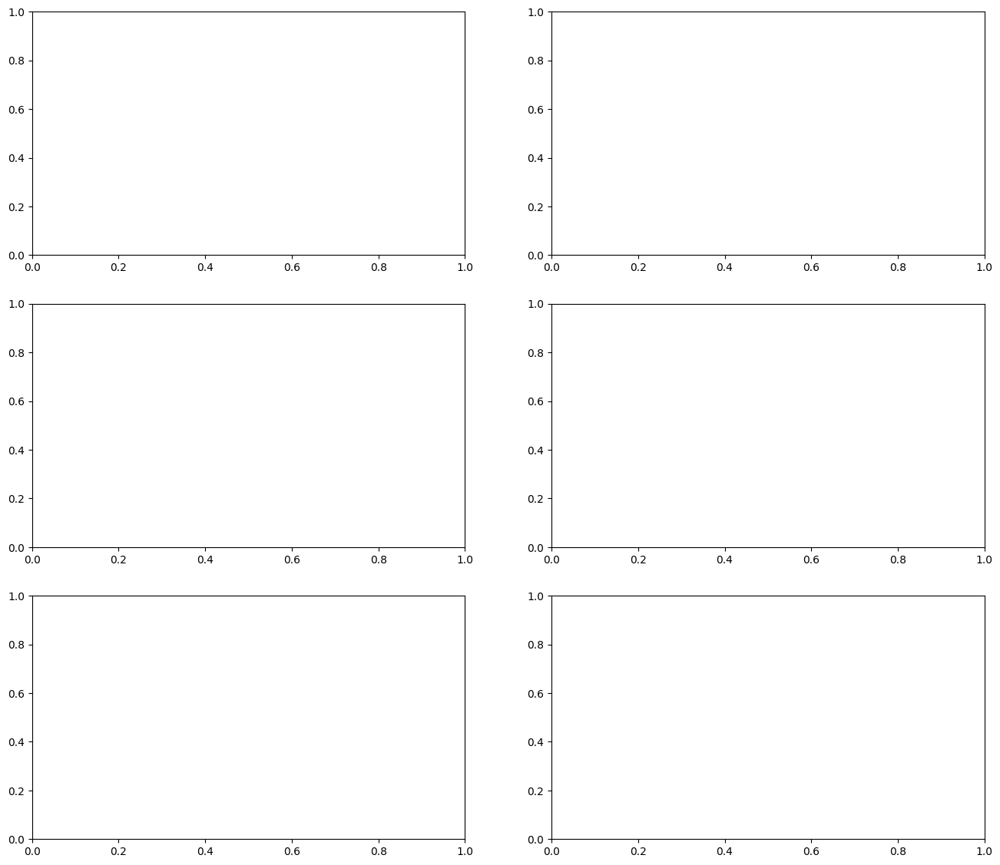

In [143]:
%matplotlib inline

plt.style.use("default")

def check_equilibrium(eps = 1e-3):
    data = np.mean(m.data['mean_links'], axis=1)
    v1 = np.mean(data[-100:-50])
    v2 = np.mean(data[-50:])
    
       
    data = np.mean(m.data['std_links'], axis=1)
    v3 = np.mean(data[-100:-50])
    v4 = np.mean(data[-50:])
    
    if abs((v2-v1)/v2) <= eps and abs((v4-v3)/v4) <= eps:
        print(f'Reached equilibrium at step {m.accepted + m.rejected}')
        m.stop = True 
            
    


STEPS = 5_000_000
SAMPLE_RATE = 1_000

# define an array of betas
betas = [5, 10, 15, 20, 25, 30]

# plot relevant observables normalized to last value
fig, axes = plt.subplots(3, 2, figsize = (16,14))

for i in range(3):
    for j in range(2):
        # initialize the grid and run the simulation
        m = StateSpace(num_colors=3, grid_size=64, beta=betas[i+3*j], init=0, bc=0, algo='metropolis')  
        observables = [m.mean_links, m.std_links, m.mean_loop_length, check_equilibrium]
        m.step(num_steps=STEPS, progress_bar=True, sample_rate=SAMPLE_RATE, observables=observables)  
        
        x = np.arange(0, m.accepted + m.rejected + 1, SAMPLE_RATE)  
        
        # normalize with mean of last 10 values 
        for ob in [m.mean_links, m.std_links, m.mean_loop_length]:
            mean = np.mean(np.sum(m.data[ob.__name__], axis=1)[-10:-1])
            axes[i,j].plot(x, np.sum(m.data[ob.__name__], axis=1) / mean , label = ob.__name__)
            
        axes[i,j].legend()
        axes[i,j].set_xlabel('steps')
        axes[i,j].set_title(r'$\beta$ = {}      reached eq. at step {}'.format(m.beta, m.accepted+m.rejected))

        axes[i,j].grid(linewidth=0.5, linestyle = '--')
        #axes[i,j].set_xticks(np.arange(0, STEPS, STEPS // 10))
        axes[i,j].ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))
        
fig.suptitle(r'Normalized observables       grid size = {}'.format(m.grid_size))
plt.savefig(MEDIA_PATH + 'equilibrium_check.pdf')
plt.show()


# TODO Study mixing time 

We expect $T_{mix} \propto n^2 \beta$ 

We say the chain has reached equilibrium when the mean of the last 10 samples of...


In [ ]:
betas = np.linspace(1, 100, 10)

STEPS = 1_000_000
SAMPLE_RATE = 100 
N = 10
steps_for_eq = []



for beta in tqdm(betas):
    curr = []
    for _ in range(N):
        # init grid
        m = stateSpace(num_colors = 3, grid_size = 32, beta = beta, init = 0, bc = 0, algo = 'metropolis')  
        eq = False
        steps = 0
        while not eq:
            # sample 10 times
            m.step(num_steps = SAMPLE_RATE * 100, progress_bar = False, sample_rate = SAMPLE_RATE, observables = [m.mean_links])  
            
            steps += m.data['steps']
            # check for eq.
            eq = check_equilibrium(m.data['mean_links'])
        curr.append(steps)
    steps_for_eq.append(np.mean(curr))
        
    

In [ ]:
plt.scatter(betas, steps_for_eq)

### Long sim

We now focus on small and big values of $\beta$, namely 2 and 64, but with $10M$ steps. 

In [ ]:
# low beta

# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 2 , init = 0, bc = 0, algo='metropolis')  

# run it
m.step(10_000_000, sample_rate = 100_000)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))

# steps
x = np.arange(0, 10_000_000, 100_000)  # we sampled every 10k steps

# normalize with mean of last 10 values 
n1 = np.mean(m.data1[-10:-1])
n2 = np.mean(m.data2[-10:-1])
n3 = np.mean(m.data3[-10:-1])


ax.plot(x, np.array(m.data1) / n1 , label = 'mean links')
ax.plot(x, np.array(m.data2) / n2, label = 'mean local time')
ax.plot(x, np.array(m.data3) / n3, label = 'mean loop length')
ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,10_100_000, 1_000_000))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

In [ ]:
# high beta

# initialize the grid
m = stateSpace(num_colors = 3, grid_size = 64, beta = 64 , init = 0, bc = 0, algo = 'metropolis')  

# run it
m.step(10_000_000, sample_rate = 100_000)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))

# steps
x = np.arange(0, 10_000_000, 100_000)  # we sampled every 10k steps

# normalize with mean of last 10 values 
n1 = np.mean(m.data1[-10:-1])
n2 = np.mean(m.data2[-10:-1])
n3 = np.mean(m.data3[-10:-1])


ax.plot(x, np.array(m.data1) / n1 , label = 'mean links')
ax.plot(x, np.array(m.data2) / n2, label = 'mean local time')
ax.plot(x, np.array(m.data3) / n3, label = 'mean loop length')
ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,10_100_000, 1_000_000))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

# Hand-crafted starting configurations

We now consider two hand-crafted initial conditions: one in which there is a loop that visits all edges, which we call **snake**, and one with uniform links but with an hole in the middle, which we call **donut**. 

In [ ]:
STEPS = 1_000_000
SAMPLE_RATE = 10_000

m = stateSpace(num_colors = 3, grid_size = 32, beta = 8 , init = 0, bc = 0, algo = 'metropolis')

# donut state as initial state
build_donut(m)

'''
        # initialize the grid and run the simulation
        m = stateSpace(num_colors = 3, grid_size = 32, beta = betas[i+3*j], init = 0, bc = 0, algo = 'metropolis')  
        observables = [m.mean_links, m.mean_local_time, m.mean_loop_length]
        m.step(num_steps = STEPS, progress_bar = False, sample_rate = SAMPLE_RATE, observables = observables)  
        
        x = np.arange(0, STEPS, SAMPLE_RATE)  
        
        # normalize with mean of last 10 values 
        for ob in observables:
            mean = np.mean(m.data[ob.__name__][-10:-1])
            axes[i,j].plot(x, np.array(m.data[ob.__name__]) / mean , label = ob.__name__)
            
        axes[i,j].legend()
        axes[i,j].set_xlabel('steps')
        axes[i,j].set_title(r'$\beta$ = {}'.format(m.beta))

        axes[i,j].grid(linewidth=0.5, linestyle = '--')
        axes[i,j].set_xticks(np.arange(0, STEPS, STEPS // 10))
        axes[i,j].ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))
'''
        
# observables to save
observables = [m.mean_links, m.mean_loop_length]
        
# run it
m.step(STEPS, sample_rate = SAMPLE_RATE, observables = observables)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))


x = np.arange(0, STEPS, SAMPLE_RATE)  # we sampled every 10k steps

# normalize with mean of last 10 values 
for ob in observables:
    mean = np.mean(m.data[ob.__name__][-10:-1])
    ax.plot(x, np.array(m.data[ob.__name__]) / mean , label = ob.__name__)


ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,STEPS, 10*SAMPLE_RATE))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

plt.show()

In [ ]:
STEPS = 10_000_000
SAMPLE_RATE = 10_000

m = stateSpace(num_colors = 3, grid_size = 32, beta = 0.7 , init = 0, bc = 0, algo = 'metropolis')

# building the snake state

build_snake(m)


# observables to save
observables = [m.mean_links]
        
# run it
m.step(STEPS, sample_rate = SAMPLE_RATE, observables = observables)  # about 3 seconds for 100k steps on my PC

# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (16,8))


x = np.arange(0, STEPS, SAMPLE_RATE)  # we sampled every 10k steps

# normalize with mean of last 10 values 
for ob in observables:
    mean = np.mean(m.data[ob.__name__][-10:-1])
    ax.plot(x, np.array(m.data[ob.__name__]) / mean , label = ob.__name__)


ax.legend()
ax.set_xlabel('steps')
ax.set_title(r'normalized observables              grid size = {}   $\beta$ = {}'.format(m.grid_size, m.beta))

ax.grid(linewidth=0.5, linestyle = '--')
ax.set_xticks(np.arange(0,STEPS, 10*SAMPLE_RATE))
ax.ticklabel_format(axis = 'x', style = 'sci', scilimits=(0,0))

In [ ]:
m.plot_overlap()

# Loops

number of loops: 487
mean length: 18.0


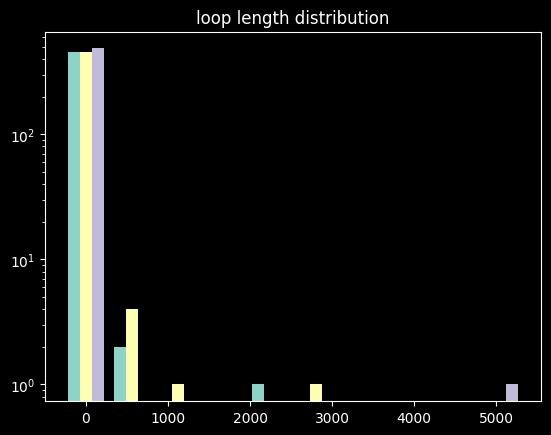

In [30]:
# choose a color
color = 2

loops, lengths = m.loop_builder()

#plt.hist(lengths, log = True, align='left', bins = range(min(lengths), max(lengths) + 2, 1))
plt.hist(lengths, log = True, align='left') #, bins = range(min(lengths), max(lengths) + 2, 1))
plt.title('loop length distribution')

print('number of loops: {}'.format(len(loops[color])))
print('mean length: {}'.format(np.mean(lengths[color])))


[0.2813218991842711, 0.09328592344697761, 0.08554695670361849, 0.04350554277347835, 0.0376490274001255, 0.03702154361012341, 0.035975737293453255, 0.025935996653419786, 0.021125287596737083, 0.017987868646726628, 0.016314578540054383, 0.014432127170048107, 0.013386320853377955, 0.010458063166701528, 0.009621418113365405, 0.007320644216691069, 0.006274837900020916, 0.006065676636686885, 0.005019870320016733, 0.00397406400334658, 0.00397406400334658, 0.00397406400334658, 0.0037649027400125496, 0.003555741476678519, 0.003555741476678519, 0.003346580213344489, 0.003346580213344489, 0.003137418950010458, 0.0029282576866764276, 0.0029282576866764276, 0.002719096423342397, 0.002719096423342397, 0.002719096423342397, 0.0025099351600083664, 0.002091612633340305, 0.0018824513700062748, 0.0018824513700062748, 0.0018824513700062748, 0.0018824513700062748, 0.0018824513700062748, 0.0018824513700062748, 0.0018824513700062748, 0.0016732901066722444, 0.0016732901066722444, 0.0016732901066722444, 0.0014

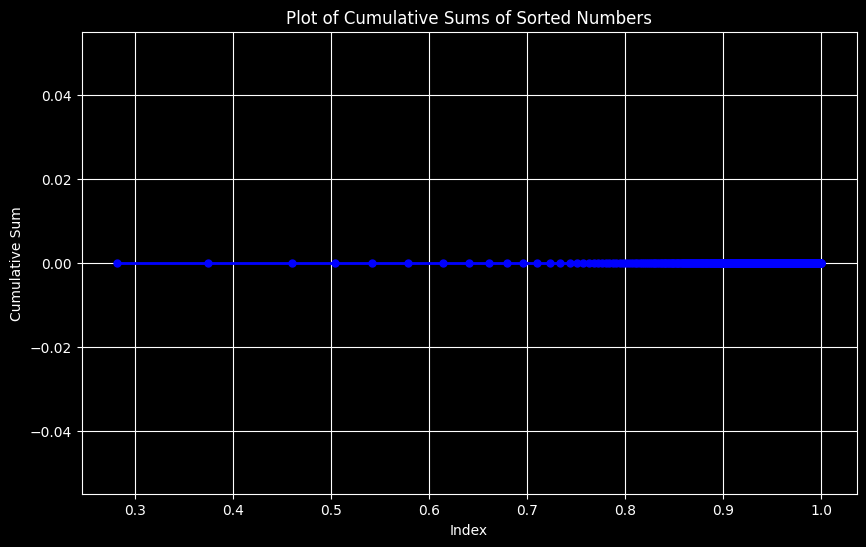

In [31]:
# normalize lenghts
tot_length = np.sum(lengths[0])

lengths_norm_sorted = sorted([l/tot_length for l in lengths[0]], reverse=True)
print(lengths_norm_sorted)
y = np.zeros_like(lengths_norm_sorted)


# Calculating the cumulative sums
cumulative_sums = [sum(lengths_norm_sorted[:i+1]) for i in range(len(lengths_norm_sorted))]

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(cumulative_sums, y, 'bo-', linewidth=2, markersize=5)  # 'bo-' creates blue circles with a line connecting them
plt.title('Plot of Cumulative Sums of Sorted Numbers')
plt.xlabel('Index')
plt.ylabel('Cumulative Sum')
plt.grid(True)
plt.show()



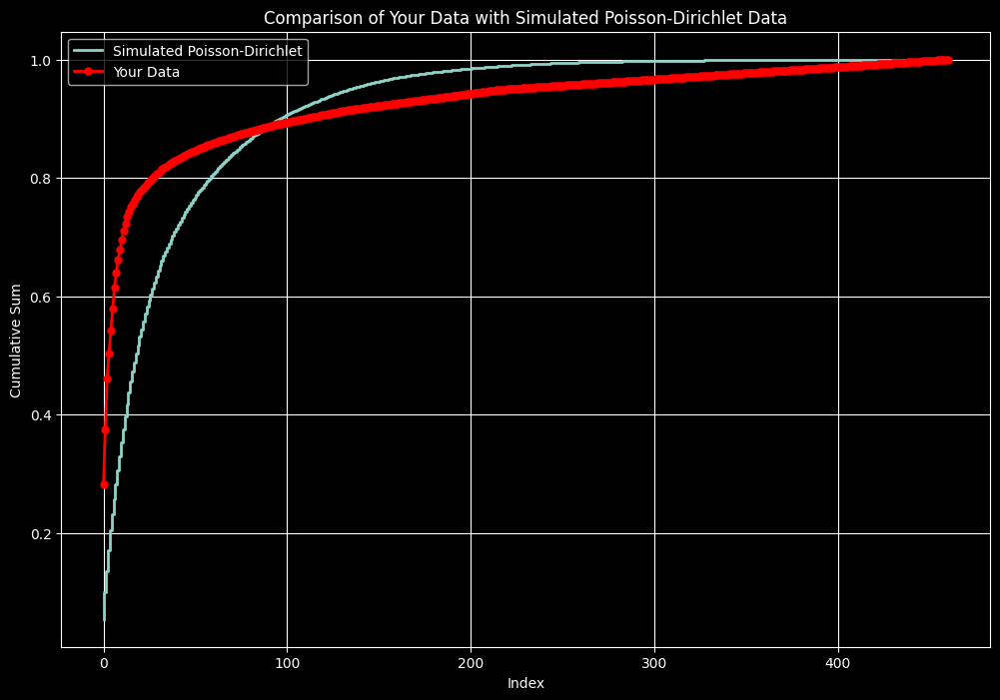

In [40]:
def simulate_stick_breaking(alpha, num_samples):
    betas = np.random.beta(1, alpha, num_samples)
    remaining_stick_lengths = np.cumprod(1 - betas)
    stick_pieces = betas * np.concatenate(([1], remaining_stick_lengths[:-1]))
    return stick_pieces

# Simulate data from the stick-breaking process
alpha = 50  # Example concentration parameter
simulated_data = simulate_stick_breaking(alpha, len(cumulative_sums))
simulated_data_sorted = np.sort(simulated_data)[::-1]
cumulative_sums_simulated = np.cumsum(simulated_data_sorted)

# Your normalized lengths data (placeholder, replace with your actual data)
# This assumes lengths_norm_sorted and cumulative_sums are defined as in your code snippet
# lengths_norm_sorted = ...

# Plotting both datasets for comparison
plt.figure(figsize=(12, 8))
plt.step(range(len(cumulative_sums_simulated)), cumulative_sums_simulated, where='mid', label='Simulated Poisson-Dirichlet', linewidth=2)
plt.plot(range(len(cumulative_sums)), cumulative_sums, 'ro-', linewidth=2, markersize=5, label='Your Data')  # Adjusted for visualization
plt.title('Comparison of Your Data with Simulated Poisson-Dirichlet Data')
plt.xlabel('Index')
plt.ylabel('Cumulative Sum')
plt.grid(True)
plt.legend()
plt.show()

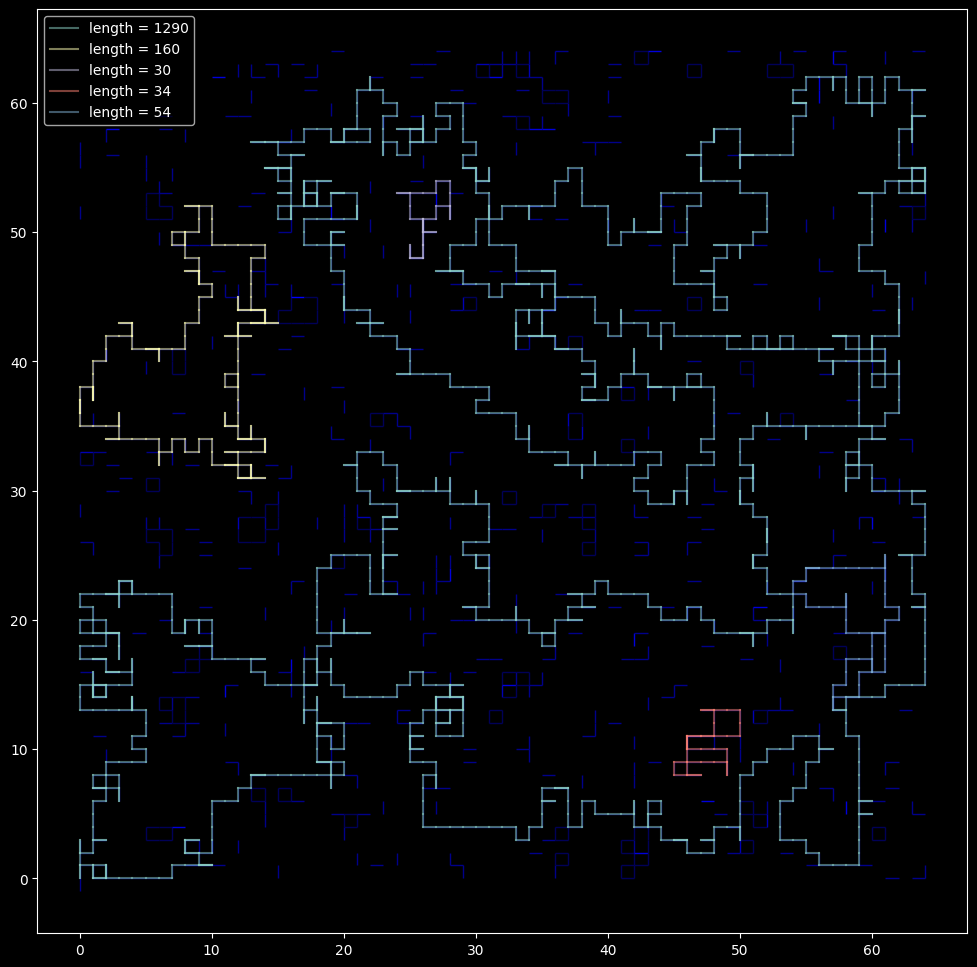

In [10]:
from itertools import cycle

colors = cycle([plt.cm.Set2(i) for i in range(8)])

# find top 10 longest loops
# print top 10
sorted = np.sort(lengths[color])[-5:]

top =  []

for l in loops[color]:
    if len(l) in sorted:
        top.append(l)

#plot it 
m.plot_loop(color, top, alpha = 0.5) #, colors=colors)

# mean links vs $\beta$
$$
\langle m \rangle = C  \beta \qquad C = 0.99966 \pm 10^{-5}
$$

indipendent of num_colors (checked for 2 and 3)

In [5]:

betas = [5, 10, 15, 20, 25, 30]

STEPS = 100_000
SAMPLE_RATE = 10_000

mean_links = []
mean_links_2 = []

for beta in tqdm(betas):
    # 3 colors
    m = StateSpace(num_colors = 3, grid_size = 32, beta = beta , init = 0, bc = 0, algo='metropolis')  #(num_colors = 3, grid_size = 10, beta = 1, uniform_init = False)  #0.1875
    # reach eq.
    m.step(500_000, progress_bar = False)
    # sample
    m.step(STEPS, sample_rate=SAMPLE_RATE, observables=[m.mean_links], progress_bar = False)
    
    mean_links.append( np.mean(np.sum(m.data['mean_links'], axis=1)) )
    
    # 2 colors
    m = StateSpace(num_colors = 2, grid_size = 32, beta = beta , init = 0, bc = 0, algo='metropolis')  #(num_colors = 3, grid_size = 10, beta = 1, uniform_init = False)  #0.1875
    # reach eq.
    m.step(500_000, progress_bar = False)
    # sample
    m.step(STEPS, sample_rate=SAMPLE_RATE, observables=[m.mean_links], progress_bar = False)
    
    mean_links_2.append( np.mean(np.sum(m.data['mean_links'], axis=1)) )
        


  0%|          | 0/6 [00:00<?, ?it/s]

N = 3    a = 0.999659 +/- 0.000011     b = -0.513 +/- 0.004
N = 2    a = 1.000341 +/- 0.000003     b = -0.256 +/- 0.001


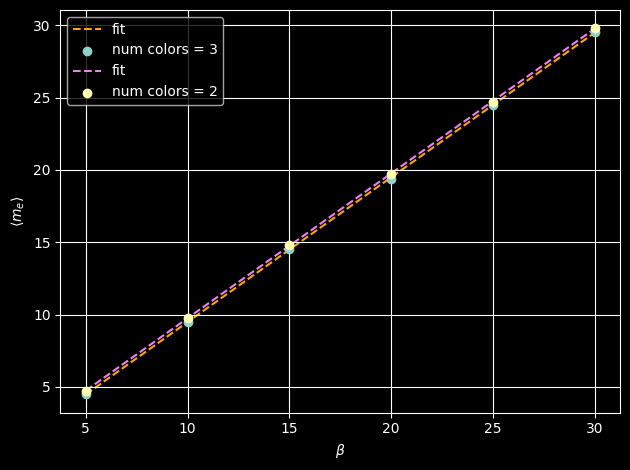

In [7]:
# acceptance_prob_optimized
def linear(x,a,b):
    return a*x + b

p, pcov = curve_fit(linear, betas, mean_links)

print('N = 3    a = {:.6f} +/- {:.6f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links, label = 'num colors = 3', zorder = 2)

p, pcov = curve_fit(linear, betas, mean_links_2)
print('N = 2    a = {:.6f} +/- {:.6f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'violet', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links_2, label = 'num colors = 2', zorder = 2)

plt.xlabel(r'$\beta$')
plt.ylabel(r'$\langle m_e \rangle$')


# Adjust layout
plt.tight_layout()

plt.legend()
plt.grid()

plt.savefig(MEDIA_PATH + 'mean_links_vs_beta_2_3.pdf')
plt.show()

In [ ]:
# acceptance_prob_old

def linear(x,a,b):
    return a*x + b

p, pcov = curve_fit(linear, betas, mean_links)

print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links, label = 'num colors = 3', zorder = 2)

p, pcov = curve_fit(linear, betas, mean_links_2)
print('N = 2    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'violet', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links_2, label = 'num colors = 2', zorder = 2)

plt.xlabel(r'$\beta$')
plt.ylabel(r'$\langle m_e \rangle$')


# Adjust layout
plt.tight_layout()

plt.legend()
plt.grid()

plt.savefig(MEDIA_PATH + 'mean_links_vs_beta_2_3.pdf')
plt.show()

In [ ]:
# acceptance_prob 

def linear(x,a,b):
    return a*x + b

p, pcov = curve_fit(linear, betas, mean_links)

print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'orange', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links, label = 'num colors = 3', zorder = 2)

p, pcov = curve_fit(linear, betas, mean_links_2)
print('N = 2    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1]))
y = [linear(beta, p[0], p[1]) for beta in betas]

plt.plot(betas,y, label = 'fit', color = 'violet', linestyle = '--', zorder = 1)
plt.scatter(betas, mean_links_2, label = 'num colors = 2', zorder = 2)

plt.xlabel(r'$\beta$')
plt.ylabel(r'$\langle m_e \rangle$')


# Adjust layout
plt.tight_layout()

plt.legend()
plt.grid()

plt.savefig(MEDIA_PATH + 'mean_links_vs_beta_2_3.pdf')
plt.show()

# Animations

In [ ]:
%matplotlib notebook



#m = stateSpace(2, 64, 0.1, init='random')
m.step(1_000_000, sample_rate=10_000, observables=[m.get_grid])
ani = m.animate()
HTML(ani.to_jshtml())

### Messing with widgets to get a simple interface

In [ ]:
ani.save('long_2_01.mp4')

# Correlations

TODO find a systematic way to determine if the decay is exponential or power law.

Determining whether a data sequence decays exponentially or follows a power law requires analyzing the data's behavior and possibly fitting both models to the data to see which provides a better fit. Here's a systematic approach to distinguish between exponential decay and power-law decay:

### 1. **Plot the Data**

- **Linear Plot**: First, plot your data as is on a linear scale. This step might not immediately reveal the decay type but is a good starting point for understanding the overall trend.
- **Log-Log Plot**: Plot the data on a log-log scale (both axes in logarithmic scale). Power-law relationships appear as straight lines in a log-log plot.
- **Semi-log Plot**: Plot the data on a semi-log scale (logarithmic y-axis and linear x-axis). Exponential decays appear as straight lines in a semi-log plot.

### 2. **Mathematical Characteristics**

- **Exponential Decay**: The ratio of consecutive values remains constant over time. In mathematical terms, if your data is represented by \(y(t)\), then \(y(t + \Delta t) / y(t)\) is constant for constant \(\Delta t\).
- **Power Law Decay**: The slope in a log-log plot is constant. This means if you plot \(\log(y)\) vs. \(\log(x)\), you should get a straight line, and the slope of this line gives you the exponent of the decay.

### 3. **Fit Both Models**

- **Exponential Model**: The general form is $y(t) = Ae^{-kt}$, where $A$ is a constant and \(k\) is the decay constant.
- **Power Law Model**: The general form is $y(t) = At^{-k}$, where $A$ is a constant and \(k\) is the power-law exponent.

Fit both models to your data using a fitting procedure such as least squares, and calculate goodness-of-fit statistics for each model, such as the coefficient of determination (\(R^2\)) or the chi-squared statistic.

### 4. **Goodness-of-Fit Comparison**

- Compare the goodness-of-fit statistics for both models. The model with a better fit (higher \(R^2\) or lower chi-squared value, depending on your metric) is more likely to describe your data accurately.
- Additionally, consider the residuals (the difference between the observed values and the model's predicted values). Ideally, the residuals should be randomly distributed without patterns for the model that fits better.

### 5. **AIC or BIC for Model Selection**

- For a more formal model comparison, use the Akaike Information Criterion (AIC) or the Bayesian Information Criterion (BIC). Both criteria take into account the goodness of fit and the number of parameters in the model, penalizing for complexity to help avoid overfitting.

### Conclusion

The process of distinguishing between exponential and power-law decays involves visual inspection, mathematical analysis, fitting both models to the data, and comparing the goodness of fit. It's important to consider the context of your data and the underlying phenomena being modeled, as this might guide your expectation regarding the most appropriate model.


In [ ]:
betas = np.linspace(1, 6, 4)
corrs = []

for beta in tqdm(betas):
    m = StateSpace(num_colors=3, grid_size= 64, beta=beta, algo='metropolis')

    # reach equilibrium
    m.step(num_steps=1_000_000, progress_bar = False)

    # sample 
    m.step(num_steps=1_000_000, sample_rate=100_000, observables=[m.compute_corr], progress_bar = False)
    
    # save 
    corrs.append(np.mean(m.data['compute_corr'], axis= (0)))
    

In [7]:
corrs_64 = np.load('./data/corr_3_64_1920.npy') #'corr_3_64.npy')
#corrs_restart = np.load('corr_3_64_960.npy')
corrs_128 = np.load('./data/corr_3_128_8k.npy')
corrs_128_lb = np.load('./data/corr_3_128_8k_low_beta.npy')

corrs_2_128 = np.load('./data/corr_2_128_800.npy') 

with open('corr_3_256_2024-03-17_12_29_40.json', 'r') as file:
    data = json.load(file)


In [13]:
corrs_256 = data['data']
np.array(corrs_256).shape

(8, 4, 129)

In [49]:
data.shape
data_t_2 = np.mean(data, axis=0).T

data_t_2.shape

(4, 129)

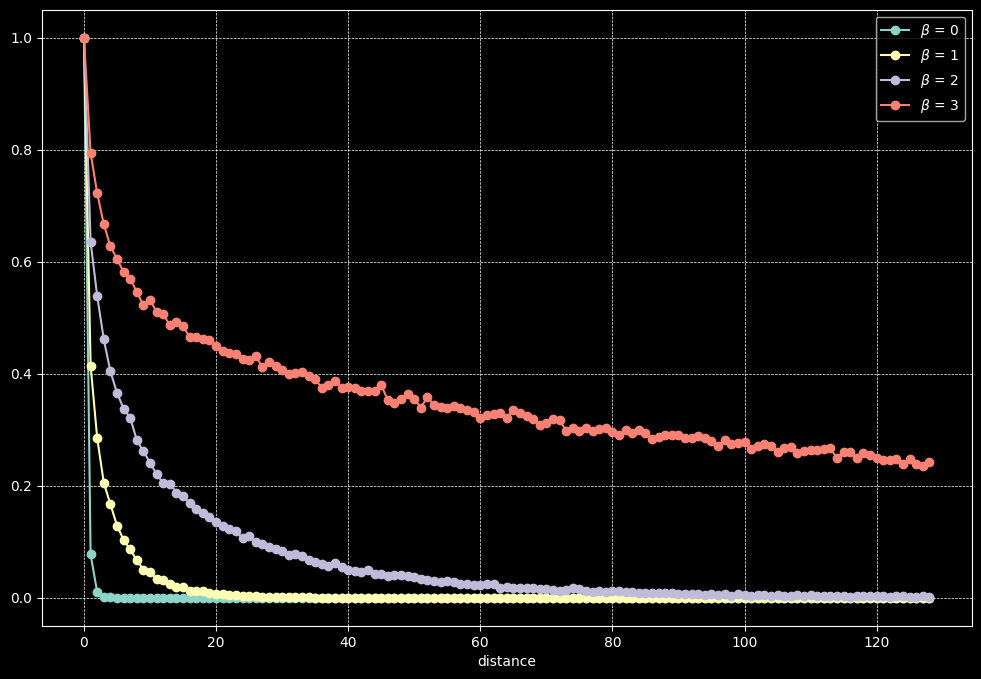

In [42]:
# RUN 2
# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (12,8))
betas = np.arange(0,8) #np.linspace(1,6,4)
for i in range(len(data_t_2)):
    x = np.arange(0, 129, 1)
    ax.plot(x, data_t_2[i], label=r'$\beta$ = {}'.format(betas[i]), marker='o')
    ax.legend()
    ax.set_xlabel('distance')
    ax.grid(linewidth=0.5, linestyle = '--')
        #ax.set_xticks(np.arange(0, STEPS, STEPS // 10))
        
#fig.suptitle(r'Normalized observables       grid size = {}'.format(m.grid_size))
plt.savefig(MEDIA_PATH + 'corr_256.pdf')
plt.show()


--- exp ---
cond = 1.0
a = 2.553 +/- 0.000
res = 1.9612290275885957e-05

--- pow ---
cond = 1.0
a = 3.751 +/- 0.000
res = 7.155429438928373e-05

--- exp ---
cond = 1.0
a = 0.586 +/- 0.000
res = 0.05392066042722199

--- pow ---
cond = 1.0
a = 1.255 +/- 0.000
res = 0.010957884519596854

--- exp ---
cond = 1.0
a = 0.151 +/- 0.000
res = 0.3432327464278223

--- pow ---
cond = 1.0
a = 0.715 +/- 0.000
res = 0.16200411004194054

--- exp ---
cond = 1.0
a = 0.019 +/- 0.000
res = 2.9676777593771373

--- pow ---
cond = 1.0
a = 0.273 +/- 0.000
res = 0.023179099127943723


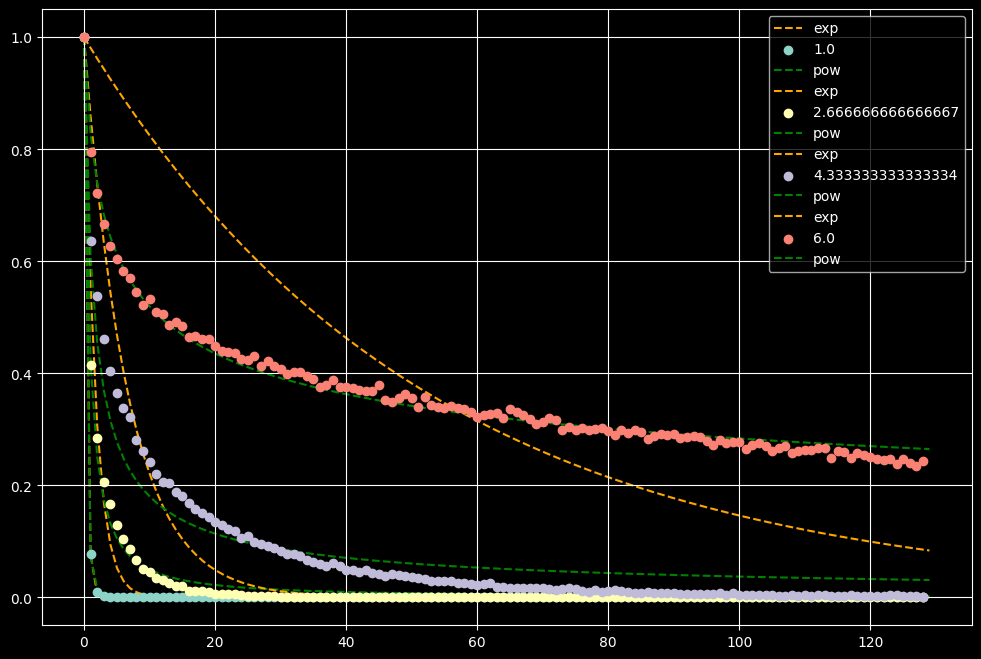

In [141]:
plt.figure(figsize=(12,8))

def my_exp(x, a, b, c):
    return a*np.exp(b * x) + c

def my_pow(x, a, b, c):
    return (x + a)**b + c

def fit_plot(data, betas):
    x = np.arange(0, len(data[0]))
    for i in range(len(data)):
        # fit best exp
        y = data[i]
        p, pcov = curve_fit(lambda x, a: np.exp(-a*x), x, y, p0 = (-1))
        print('\n--- exp ---')
        print(f'cond = {np.linalg.cond(pcov)}')
        print('a = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0]))
        #print('beta =  {:.3f} |  N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1]))

        x_fit = np.linspace(0, len(data[0]), len(data[0]))
        y_fit_exp = np.exp(-x_fit * p[0])

        res = np.sum( (y-y_fit_exp)**2)
        print(f'{res = }')
        
        plt.plot(x_fit, y_fit_exp, label = 'exp', color = 'orange', linestyle = '--', zorder = 1)
        plt.scatter(x, y, label = f'{betas[i]}', zorder = 2)


        # fit best pow
        p, pcov = curve_fit(lambda x, a: 1/(x+1)**a, x, y, p0 = (1), maxfev=10_000)
        print('\n--- pow ---')
        print(f'cond = {np.linalg.cond(pcov)}')
        print('a = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0]))
        y_fit_pow = 1/(x_fit+1)**p[0]
        
        res = np.sum( (y-y_fit_pow)**2)
        print(f'{res = }')

        plt.plot(x_fit, y_fit_pow, label = 'pow', color = 'green', linestyle = '--', zorder = 1)
        
                 
    plt.legend()
    plt.grid()
    plt.show()
    
fit_plot(data_t_2, np.linspace(1, 6, 4))


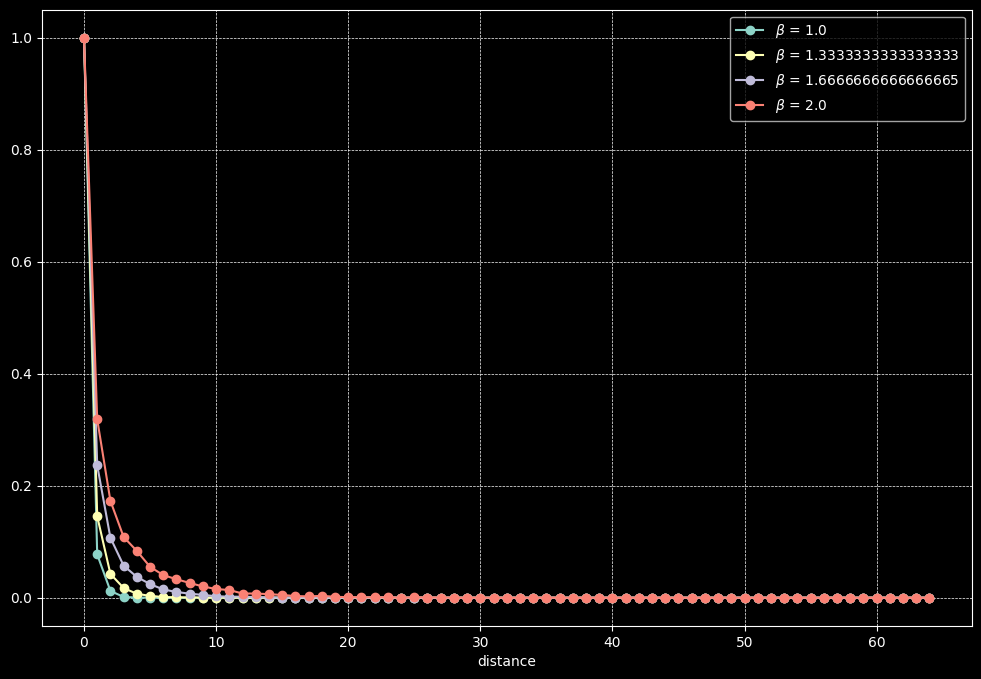

In [53]:
# RUN 2
# plot relevant observables normalized to last value
fig, ax = plt.subplots(figsize = (12,8))
betas = np.linspace(1,2,4)
for i in range(4):

        x = np.arange(0, 128 // 2+1, 1)

        ax.plot(x, corrs_128_lb[i], label=r'$\beta$ = {}'.format(betas[i]), marker='o')
            
        ax.legend()
        ax.set_xlabel('distance')
       
        ax.grid(linewidth=0.5, linestyle = '--')
        #ax.set_xticks(np.arange(0, STEPS, STEPS // 10))
        
#fig.suptitle(r'Normalized observables       grid size = {}'.format(m.grid_size))
plt.show()

In [ ]:
corrs_1k = [
    [1., 0.015625, 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
    [1., 0.3625, 0.1875, 0.125, 0.0875, 0.065625, 0.03125, 0.025, 0.003125, 0.0125, 0.003125, 0.0125, 0.003125, 0.003125, 0., 0.00625],
    [1., 0.6125, 0.496875, 0.446875, 0.3875, 0.3375, 0.30625, 0.2625, 0.3, 0.25, 0.234375, 0.228125, 0.175, 0.178125, 0.16875, 0.134375],
    [1., 0.809375, 0.75625, 0.728125, 0.734375, 0.69375, 0.65, 0.634375, 0.56875, 0.6, 0.578125, 0.584375, 0.540625, 0.534375, 0.584375, 0.546875]
]


In [ ]:
file_name = 'corrs_1.npy'

with open(file_name, 'wb') as file:
    np.save(file, corrs)


--- exp ---

cond = 1086.1435687672924
beta = 1.000 |  a = 0.996 +/- 0.000   b = -1.471 +/- 0.001   c = 0.002 +/- 0.000

--- pow ---

cond = 1963.2881494407234
beta = 1.000 |  a = 1.000 +/- 0.000   b = -2.256 +/- 0.000   c = -0.001 +/- 0.000

--- exp ---

cond = 44.35473792481879
beta = 2.667 |  a = 0.748 +/- 0.001   b = -0.137 +/- 0.000   c = 0.055 +/- 0.000

--- pow ---

cond = 8283.641453887429
beta = 2.667 |  a = 0.562 +/- 0.017   b = -0.350 +/- 0.003   c = -0.207 +/- 0.003

--- exp ---

cond = 49.38269704437929
beta = 4.333 |  a = 0.434 +/- 0.000   b = -0.071 +/- 0.000   c = 0.449 +/- 0.000

--- pow ---

cond = 155665.53290412104
beta = 4.333 |  a = 1.549 +/- 0.245   b = -0.256 +/- 0.004   c = 0.100 +/- 0.007

--- exp ---

cond = 100.4659107702711
beta = 6.000 |  a = 0.296 +/- 0.000   b = -0.046 +/- 0.000   c = 0.660 +/- 0.000

--- pow ---

cond = 12835490.616172679
beta = 6.000 |  a = 5.056 +/- 17.990   b = -0.244 +/- 0.084   c = 0.317 +/- 0.197


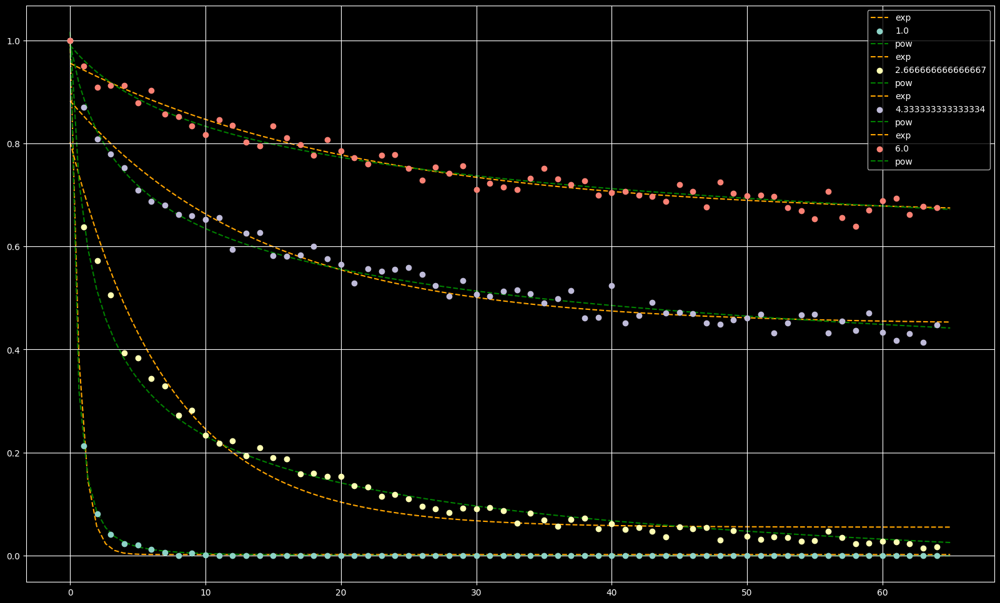

In [43]:
betas = np.linspace(1,6,4)

plt.figure(figsize=(20,12))

def my_exp(x, a, b, c):
    return a*np.exp(b * x) + c

def my_pow(x, a, b, c):
    return (x + a)**b + c

# dump first values, convergence not reached 
y = corrs_128[2]
x = np.arange(0, 128 // 2 + 1)
#plt.plot(list(range(0, m.grid_size // 2, 2)), y, 'o')

for i in range(len(corrs_128)):
    # fit best exp
    y = corrs_2_128[i]
    p, pcov = curve_fit(my_exp, x, y, p0 = (1,-1, 0))
    print('\n--- exp ---')
    print(f'\ncond = {np.linalg.cond(pcov)}')
    print('beta = {:.3f} |  a = {:.3f} +/- {:.3f}   b = {:.3f} +/- {:.3f}   c = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1], p[2], pcov[2][2]))
    #print('beta =  {:.3f} |  N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1]))

    x_fit = np.linspace(0, 65, 100)
    y_fit = [my_exp(k, *p) for k in x_fit]

    plt.plot(x_fit, y_fit, label = 'exp', color = 'orange', linestyle = '--', zorder = 1)
    plt.scatter(x, y, label = f'{betas[i]}', zorder = 2)


    # fit best pow
    p, pcov = curve_fit(my_pow, x, y, p0 = (1,-1, 0), maxfev=10_000)
    print('\n--- pow ---')
    print(f'\ncond = {np.linalg.cond(pcov)}')
    print('beta = {:.3f} |  a = {:.3f} +/- {:.3f}   b = {:.3f} +/- {:.3f}   c = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1], p[2], pcov[2][2]))

    x_fit = np.linspace(0, 65, 100)
    y_fit = [my_pow(k, *p) for k in x_fit]

    plt.plot(x_fit, y_fit, label = 'pow', color = 'green', linestyle = '--', zorder = 1)
plt.legend()
plt.grid()
plt.show()


### Residue


--- exp ---
cond = 1.0
a = 2.553 +/- 0.000
sigma = 0.00038628702997589673

--- pow ---
cond = 1.0
a = 3.751 +/- 0.000
sigma = 0.0007402513357990193

--- exp ---
cond = 1.0
a = 0.586 +/- 0.000
sigma = 0.02003195321436042

--- pow ---
cond = 1.0
a = 1.255 +/- 0.000
sigma = 0.007971640137169186

--- exp ---
cond = 1.0
a = 0.151 +/- 0.000
sigma = 0.0479752549507523

--- pow ---
cond = 1.0
a = 0.715 +/- 0.000
sigma = 0.03344429584400116

--- exp ---
cond = 1.0
a = 0.019 +/- 0.000
sigma = 0.1512259317889622

--- pow ---
cond = 1.0
a = 0.273 +/- 0.000
sigma = 0.013401333308921766


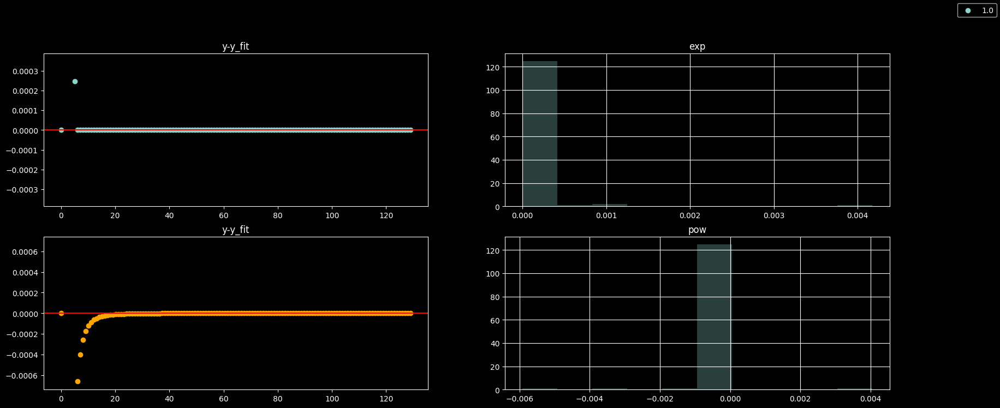

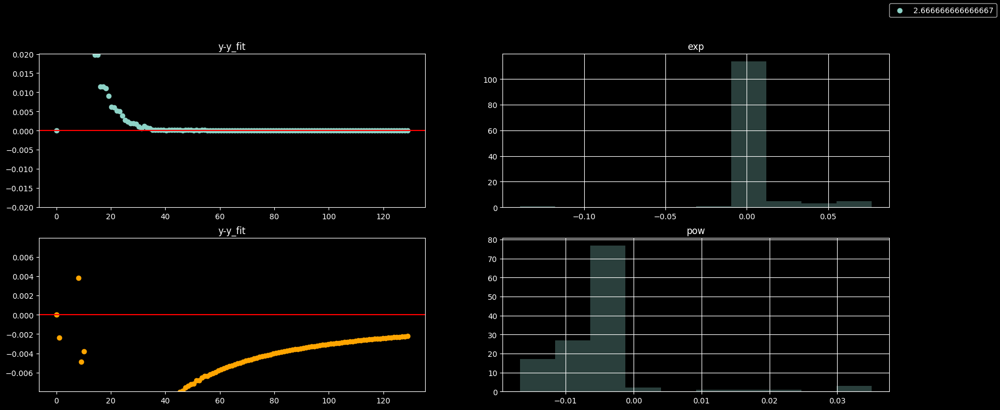

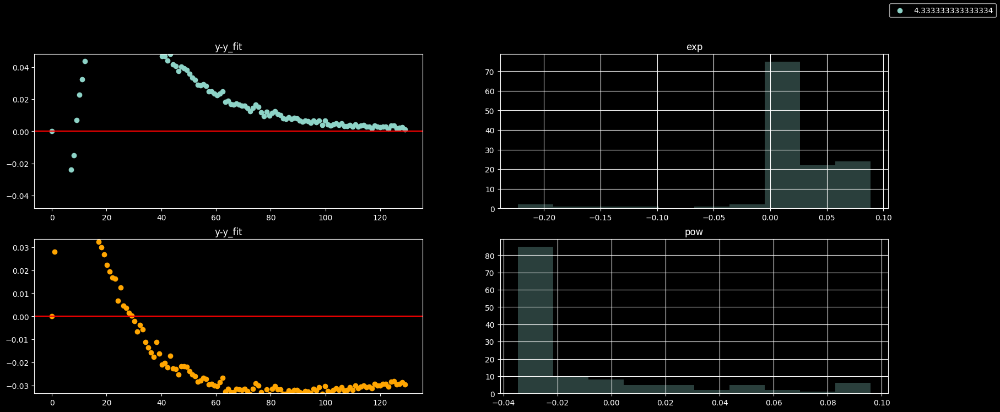

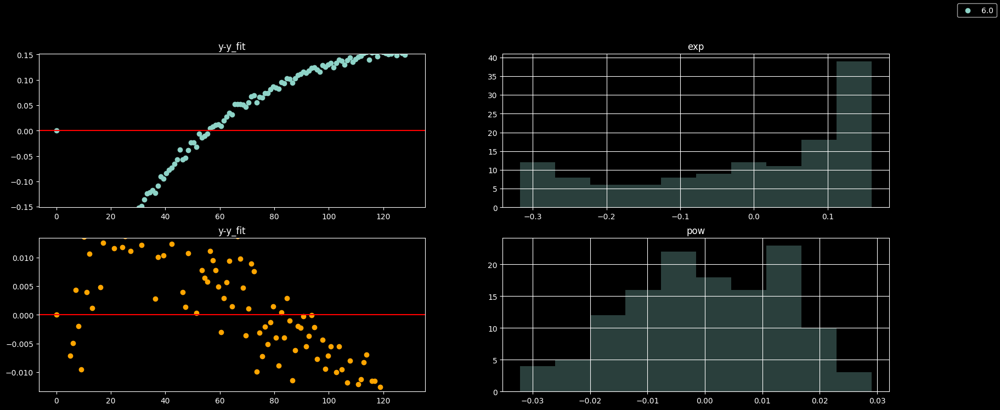

In [137]:
# study residues

def residue_plot(data, beta):
    fig, ax = plt.subplots(2, 2, figsize=(20,8))
    x = np.arange(0, len(data))
    #plt.plot(list(range(0, m.grid_size // 2, 2)), y, 'o')

    # fit best exp
    y = data
    p, pcov = curve_fit(lambda x, a: np.exp(-a*x), x, y, p0 = (-1))
    print('\n--- exp ---')
    print(f'cond = {np.linalg.cond(pcov)}')
    print('a = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0]))
    #print('beta =  {:.3f} |  N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1]))

    x_fit = np.linspace(0, len(data), len(data))
    y_fit_exp = np.exp(-x_fit * p[0])

    sigma = np.std(y-y_fit_exp)
    print(f'{sigma = }')
    ax[0,0].set_ylim([-sigma, sigma])
    ax[0,0].scatter(x_fit, y-y_fit_exp, label = f'{beta}', zorder = 2)
    
    ax[0,0].set_title('y-y_fit')
    ax[0,0].axline([0,0], [len(data), 0], linestyle='-', c='r')
    ax[0,1].hist(y-y_fit_exp, alpha=0.3)
    ax[0,1].set_title('exp')
    
    # fit best pow
    p, pcov = curve_fit(lambda x, a: 1/(x+1)**a, x, y, p0 = (1), maxfev=10_000)
    print('\n--- pow ---')
    print(f'cond = {np.linalg.cond(pcov)}')
    print('a = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0]))
    y_fit_pow = 1/(x_fit+1)**p[0]
    
    sigma = np.std(y-y_fit_pow)
    print(f'{sigma = }')
    ax[1,0].set_ylim([-sigma, sigma])
    ax[1,0].scatter(x_fit, y-y_fit_pow, zorder = 1, c='orange')
    ax[1,0].set_title('y-y_fit')
    ax[1,0].axline([0,0], [len(data), 0], linestyle='-', c='r')
    ax[1,1].hist(y-y_fit_pow, alpha=0.3)
    ax[1,1].set_title('pow')
            
    fig.legend()
    ax[0,1].grid()
    ax[1,1].grid()


for i in range(4):
    residue_plot(data_t_2[i], betas[i])
    

In [ ]:


plt.figure(figsize=(20,12))

betas = np.linspace(1,6,4)
for i in range(len(corrs_2_128)):
    
    # fit best exp
    y = np.log(corrs_2_128[i])
    is_neg_inf = np.isinf(y)
    # Filter out -inf values
    y = y[~is_neg_inf]
    x = np.arange(0, len(y))
    
    p, pcov = curve_fit(lambda x,a,b: a*x+b, x, y, p0 = (1,-1))

    #print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}     c = {:.3f} +/- {:.3f}    d = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1], p[2], pcov[2][2], p[3], pcov[3][3]))
    print('beta =  {:.3f}  N = 3  |  a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1]))

    x_fit = np.linspace(0, len(y), 100)
    y_fit = [np.exp(k*p[0]+ p[1]) for k in x_fit]

    plt.plot(x_fit, y_fit, label = 'fit', linestyle = '--', zorder = 1)
    plt.scatter(np.arange(len(corrs_2_128[i])), corrs_2_128[i], label = f'{betas[i]}', zorder = 2)
    

    plt.legend()
    plt.yscale('log')
    plt.xscale('log')

plt.grid()
plt.show()

C:\Users\lollo\AppData\Local\Temp\ipykernel_20000\1465088538.py:6: RuntimeWarning: divide by zero encountered in log
  y = np.log(data[i])


beta =  1.000 |  N = 3    a = -1.671 +/- 0.030     b = -0.749 +/- 0.272
beta =  2.667 |  N = 3    a = -0.179 +/- 0.000     b = -1.249 +/- 0.018
beta =  4.333 |  N = 3    a = -0.042 +/- 0.000     b = -1.105 +/- 0.002
beta =  6.000 |  N = 3    a = -0.007 +/- 0.000     b = -0.624 +/- 0.000


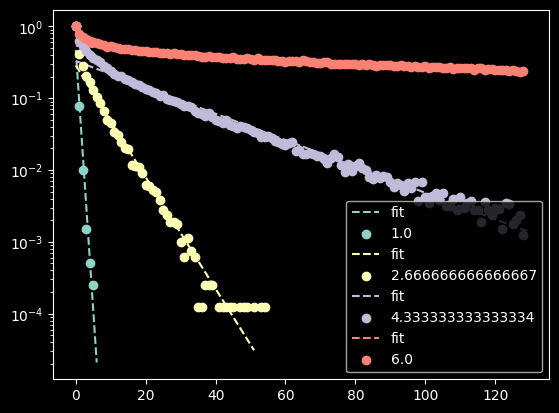

In [61]:

data = data_t_2
betas = np.linspace(1, 6, 4)
for i in range(len(data)):
    
    # fit best exp
    y = np.log(data[i])
    is_neg_inf = np.isinf(y)
    # Filter out -inf values
    y = y[~is_neg_inf]
    x = np.arange(0, len(y))
    
    p, pcov = curve_fit(lambda x,a,b: a*x+b, x, y, p0 = (1,-1))

    #print('N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}     c = {:.3f} +/- {:.3f}    d = {:.3f} +/- {:.3f}'.format(p[0], pcov[0][0], p[1], pcov[1][1], p[2], pcov[2][2], p[3], pcov[3][3]))
    print('beta =  {:.3f} |  N = 3    a = {:.3f} +/- {:.3f}     b = {:.3f} +/- {:.3f}'.format(betas[i], p[0], pcov[0][0], p[1], pcov[1][1]))

    x_fit = np.linspace(0, len(y), 100)
    y_fit = [np.exp(k*p[0]+ p[1]) for k in x_fit]

    plt.plot(x_fit, y_fit, label = 'fit', linestyle = '--', zorder = 1)
    plt.scatter(np.arange(len(data[i])), data[i], label = f'{betas[i]}', zorder = 2)
    

    plt.legend()
    plt.yscale('log')

In [ ]:
plt.style.use("dark_background")
# reach equilibrium

m = stateSpace(3, 32, 4)
m.step(num_steps=10_000, sample_rate=1000, observables=[ (lambda : m.get_local_time(16,16), 'local time'), m.max_links])
m.plot_grid()


# Figures for the thesis

In [ ]:
# prob ratios goes to zero with $U^{+1}$ and enought links on the edges


def acc_prob(beta, m):
    return beta**4 * (2*m+1) / ( (m+1)**4 * (3/2 + m))

x = np.arange(0, 5, 1)


y = [acc_prob(1, m) for m in x]
lab = r'$\beta$ = ' + str(b)
plt.scatter(x, y, marker='o', edgecolor='black', s=40)  # Customizing marker style, color, and size


plt.xlabel(r'$m_e^i$', fontsize=14)  # Customizing x-axis label and font size
plt.ylabel(r"$\frac{\rho(m')}{\rho(m)}$", fontsize=14)  # Customizing y-axis label and font size
#plt.title('', fontsize=16)   # Adding title and customizing font size
plt.grid(True)                           # Adding grid
plt.xticks(np.arange(min(x), max(x)+1, 1), fontsize=12)                  # Customizing x-axis tick font size
plt.yticks(fontsize=12)                  # Customizing y-axis tick font size
plt.tight_layout()                       # Adjust layout to prevent clipping of labels
plt.savefig(r'C:\Users\lollo\Documents\Università\Thesis\Media/acc_prob.pdf')

In [ ]:
def generate_tikz_code(matrix):
    rows = len(matrix)
    cols = len(matrix[0])

    tikz_code = "\\begin{tikzpicture}[scale=2]\n"
    
    # Grid lines with edge labels
    for i in range(3):
        for j in range(3):
                tikz_code += f"\\draw ({j},{i}) -- ({j+1},{i}) node[midway,below, font = \\footnotesize] {{{horiz[3*i+j]}}};\n"  # Horizontal edges
                tikz_code += f"\\draw ({j},{i}) -- ({j},{i+1}) node[midway,left, font = \\footnotesize] {{{vert[3*j+i]}}};\n"   # Vertical edges
    
    # Adding top and left edges
    for i in range(3):
        tikz_code += f"\\draw ({i},{3}) -- ({i+1},{3}) node[midway,below, font = \\footnotesize] {{{horiz[3*i+3]}}};\n"  # Horizontal edges
    
    for i in range(3):
        tikz_code += f"\\draw ({3},{i}) -- ({3},{i+1}) node[midway,left, font = \\footnotesize] {{{horiz[3*i+3]}}};\n"  # Horizontal edges

    # Circles at each intersection
    for i in range(cols):
        for j in range(rows):
            tikz_code += f"\\filldraw ({i},{j}) circle (1pt);\n"  # Reduced circle size to 0.5pt
    
    tikz_code += "\\end{tikzpicture}"
    
    return tikz_code

# Example usage
horiz = np.random.randint(0,4,12)
vert = np.random.randint(0,4,12)
tikz_code = generate_tikz_code(matrix)
print(tikz_code)
